# **<div align="center"> PROJETO FINAL**
# **<div align="center"> FAKE NEWS DETECTION**
---

ALUNO: José RCF Neto

In [ ]:
#Importando alguns modulos que serão utilizados inicialmente.

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import nltk
import re
from wordcloud import WordCloud
import tensorflow as tf
import json
from joblib import dump, load

#Configurando meu notebook google colab para usar GPU no back end.

tf.config.list_physical_devices('GPU')

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [ ]:
#Importando o arquivo que iremos processar.

from google.colab import files

uploaded = files.upload()

Saving news.csv to news (1).csv


In [ ]:
#Apresentando o arquivo mencionado acima em forma de DataFrame pandas.

import io

df = pd.read_csv(io.BytesIO(uploaded['news.csv']), engine='python')

In [ ]:
df

,Unnamed: 0,title,text,label
0,8476,You Can Smell Hillary’s Fear,"Daniel Greenfield, a Shillman Journalism Fello...",FAKE
1,10294,Watch The Exact Moment Paul Ryan Committed Pol...,Google Pinterest Digg Linkedin Reddit Stumbleu...,FAKE
2,3608,Kerry to go to Paris in gesture of sympathy,U.S. Secretary of State John F. Kerry said Mon...,REAL
3,10142,Bernie supporters on Twitter erupt in anger ag...,"— Kaydee King (@KaydeeKing) November 9, 2016 T...",FAKE
4,875,The Battle of New York: Why This Primary Matters,It's primary day in New York and front-runners...,REAL
...,...,...,...,...
6330,4490,State Department says it can't find emails fro...,The State Department told the Republican Natio...,REAL
6331,8062,The ‘P’ in PBS Should Stand for ‘Plutocratic’ ...,The ‘P’ in PBS Should Stand for ‘Plutocratic’ ...,FAKE
6332,8622,Anti-Trump Protesters Are Tools of the Oligarc...,Anti-Trump Protesters Are Tools of the Oligar...,FAKE
6333,4021,"In Ethiopia, Obama seeks progress on peace, se...","ADDIS ABABA, Ethiopia —President Obama convene...",REAL


In [ ]:
#Analisando a presença de valores nulos no DataFrame.

df.isnull().sum()

Unnamed: 0    0
title         0
text          0
label         0
dtype: int64

In [ ]:
#Shape do DataFrame obtido

df.shape

(6335, 4)

In [ ]:
#Analisando se nosso df é balanceado ou não.

df['label'].value_counts()

REAL    3171
FAKE    3164
Name: label, dtype: int64

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


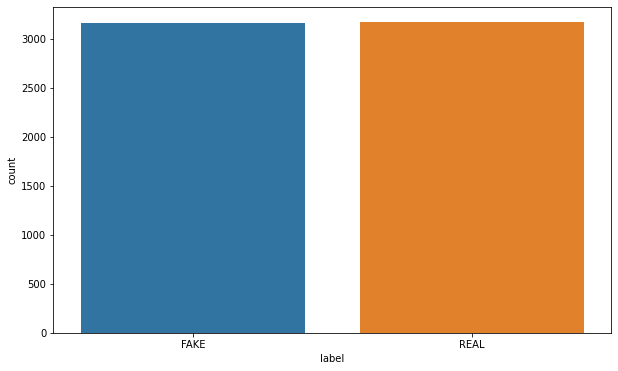

In [ ]:
#Visualizando se nosso df é balanceado ou não.
#Nosso df é balanceado.

plt.figure(figsize = (10,6))
sns.countplot('label', data = df)
plt.show()

In [ ]:
#Selecionando apenas dados FAKE.

fake_df =df.query("label == 'FAKE'")
fake_df

,Unnamed: 0,title,text,label
0,8476,You Can Smell Hillary’s Fear,"Daniel Greenfield, a Shillman Journalism Fello...",FAKE
1,10294,Watch The Exact Moment Paul Ryan Committed Pol...,Google Pinterest Digg Linkedin Reddit Stumbleu...,FAKE
3,10142,Bernie supporters on Twitter erupt in anger ag...,"— Kaydee King (@KaydeeKing) November 9, 2016 T...",FAKE
5,6903,"Tehran, USA","\nI’m not an immigrant, but my grandparents ...",FAKE
6,7341,Girl Horrified At What She Watches Boyfriend D...,"Share This Baylee Luciani (left), Screenshot o...",FAKE
...,...,...,...,...
6326,6143,DOJ COMPLAINT: Comey Under Fire Over Partisan ...,DOJ COMPLAINT: Comey Under Fire Over Partisan ...,FAKE
6328,9337,Radio Derb Is On The Air–Leonardo And Brazil’s...,,FAKE
6329,8737,Assange claims ‘crazed’ Clinton campaign tried...,Julian Assange has claimed the Hillary Clinton...,FAKE
6331,8062,The ‘P’ in PBS Should Stand for ‘Plutocratic’ ...,The ‘P’ in PBS Should Stand for ‘Plutocratic’ ...,FAKE


In [ ]:
#Processando os dados FAKE para obter uma wordcloud.

text_fake = ''.join(fake_df['text'].tolist())

<function matplotlib.pyplot.show>

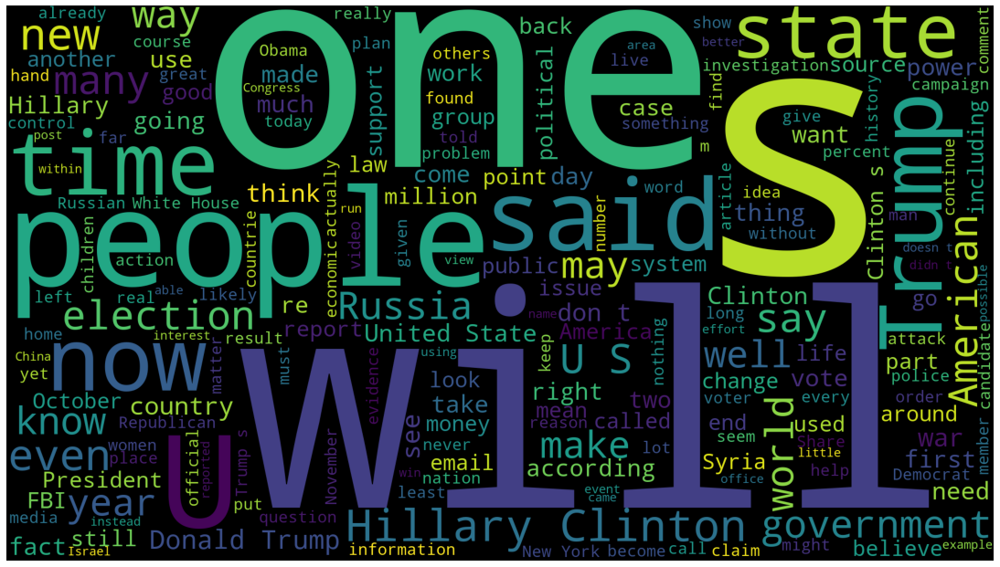

In [ ]:
#Visualizando wordcloud associada aos dados FAKE (apresentação dos termos mais frequentes).

wordcloud = WordCloud(width = 1920, height = 1080).generate(text_fake)
fig = plt.figure(figsize = (15,10))
plt.imshow(wordcloud)
plt.axis('off')
plt.tight_layout(pad = 0)
plt.show

In [ ]:
#Selecionando apenas dados REAL.

real_df =df.query("label == 'REAL'")
real_df

,Unnamed: 0,title,text,label
2,3608,Kerry to go to Paris in gesture of sympathy,U.S. Secretary of State John F. Kerry said Mon...,REAL
4,875,The Battle of New York: Why This Primary Matters,It's primary day in New York and front-runners...,REAL
7,95,‘Britain’s Schindler’ Dies at 106,A Czech stockbroker who saved more than 650 Je...,REAL
8,4869,Fact check: Trump and Clinton at the 'commande...,Hillary Clinton and Donald Trump made some ina...,REAL
9,2909,Iran reportedly makes new push for uranium con...,Iranian negotiators reportedly have made a las...,REAL
...,...,...,...,...
6324,2316,Alabama Lawmaker: Same-Sex Couples Don’t Deser...,Most conservatives who oppose marriage equalit...,REAL
6327,3262,GOP Senator David Perdue Jokes About Praying f...,The freshman senator from Georgia quoted scrip...,REAL
6330,4490,State Department says it can't find emails fro...,The State Department told the Republican Natio...,REAL
6333,4021,"In Ethiopia, Obama seeks progress on peace, se...","ADDIS ABABA, Ethiopia —President Obama convene...",REAL


In [ ]:
#Processando os dados REAL para obter uma wordcloud.

text_real = ''.join(real_df['text'].tolist())

<function matplotlib.pyplot.show>

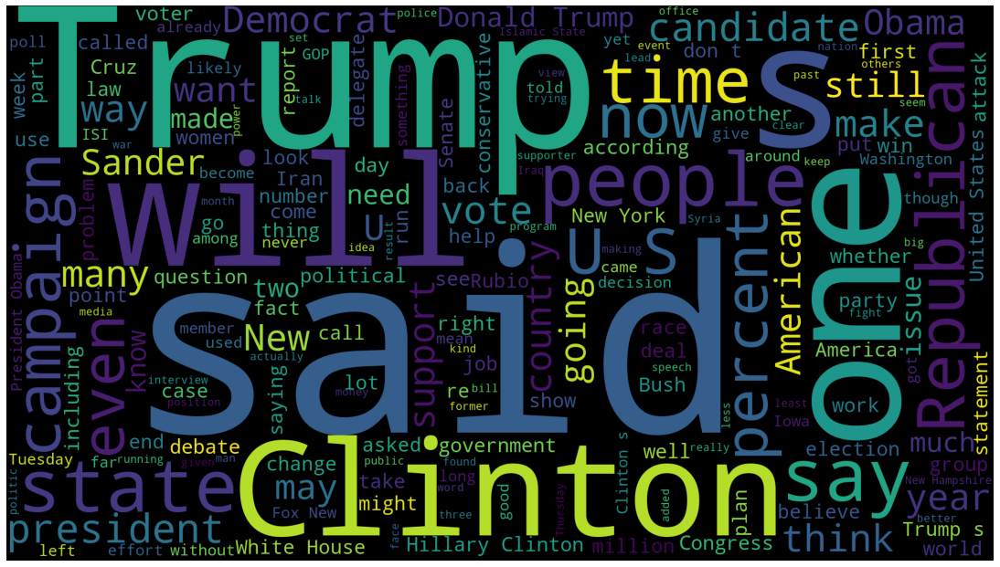

In [ ]:
#Visualizando wordcloud associada aos dados REAL (apresentação dos termos mais frequentes).

wordcloud = WordCloud(width = 1920, height = 1080).generate(text_real)
fig = plt.figure(figsize = (15,10))
plt.imshow(wordcloud)
plt.axis('off')
plt.tight_layout(pad = 0)
plt.show

In [ ]:
#Iniciando pré-processamento dos dados.
#Transformando todas as plavras em minúsculas.

df['text'] = df['text'].apply(lambda x: str(x).lower())
df

,Unnamed: 0,title,text,label
0,8476,You Can Smell Hillary’s Fear,"daniel greenfield, a shillman journalism fello...",FAKE
1,10294,Watch The Exact Moment Paul Ryan Committed Pol...,google pinterest digg linkedin reddit stumbleu...,FAKE
2,3608,Kerry to go to Paris in gesture of sympathy,u.s. secretary of state john f. kerry said mon...,REAL
3,10142,Bernie supporters on Twitter erupt in anger ag...,"— kaydee king (@kaydeeking) november 9, 2016 t...",FAKE
4,875,The Battle of New York: Why This Primary Matters,it's primary day in new york and front-runners...,REAL
...,...,...,...,...
6330,4490,State Department says it can't find emails fro...,the state department told the republican natio...,REAL
6331,8062,The ‘P’ in PBS Should Stand for ‘Plutocratic’ ...,the ‘p’ in pbs should stand for ‘plutocratic’ ...,FAKE
6332,8622,Anti-Trump Protesters Are Tools of the Oligarc...,anti-trump protesters are tools of the oligar...,FAKE
6333,4021,"In Ethiopia, Obama seeks progress on peace, se...","addis ababa, ethiopia —president obama convene...",REAL


In [ ]:
#Adicionando uma nova coluna com a apresentação numérica dos labels.
#FAKE = 0; REAL = 1

df['class'] = np.where(df['label'] == 'REAL', 1, 0)
df

,Unnamed: 0,title,text,label,class
0,8476,You Can Smell Hillary’s Fear,"daniel greenfield, a shillman journalism fello...",FAKE,0
1,10294,Watch The Exact Moment Paul Ryan Committed Pol...,google pinterest digg linkedin reddit stumbleu...,FAKE,0
2,3608,Kerry to go to Paris in gesture of sympathy,u.s. secretary of state john f. kerry said mon...,REAL,1
3,10142,Bernie supporters on Twitter erupt in anger ag...,"— kaydee king (@kaydeeking) november 9, 2016 t...",FAKE,0
4,875,The Battle of New York: Why This Primary Matters,it's primary day in new york and front-runners...,REAL,1
...,...,...,...,...,...
6330,4490,State Department says it can't find emails fro...,the state department told the republican natio...,REAL,1
6331,8062,The ‘P’ in PBS Should Stand for ‘Plutocratic’ ...,the ‘p’ in pbs should stand for ‘plutocratic’ ...,FAKE,0
6332,8622,Anti-Trump Protesters Are Tools of the Oligarc...,anti-trump protesters are tools of the oligar...,FAKE,0
6333,4021,"In Ethiopia, Obama seeks progress on peace, se...","addis ababa, ethiopia —president obama convene...",REAL,1


In [ ]:
#Fazendo um DataFrame de 'trabalho'. Esse irá servir de base para as análises posteriores.

df_work = df[['text', 'class']]
df_work

,text,class
0,"daniel greenfield, a shillman journalism fello...",0
1,google pinterest digg linkedin reddit stumbleu...,0
2,u.s. secretary of state john f. kerry said mon...,1
3,"— kaydee king (@kaydeeking) november 9, 2016 t...",0
4,it's primary day in new york and front-runners...,1
...,...,...
6330,the state department told the republican natio...,1
6331,the ‘p’ in pbs should stand for ‘plutocratic’ ...,0
6332,anti-trump protesters are tools of the oligar...,0
6333,"addis ababa, ethiopia —president obama convene...",1


In [ ]:
#Instalando bibliotecas que são pré-requisitos para a bibliteca que usaremos para executar uma etapa de pré-processamento.

!pip install spacy == 2.2.3
!python -m spacy download en_core_web_sm
!pip install beautifulsoup4 == 4.9.1
!pip install textblob == 0.15.3
!pip install git+https://github.com/laxmimerit/preprocess_kgptalkie.git --upgrade --force-reinstall

ERROR: Invalid requirement: '=='
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 12.8 MB 2.7 MB/s 
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_sm')
ERROR: Invalid requirement: '=='
ERROR: Invalid requirement: '=='
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/laxmimerit/preprocess_kgptalkie.git to /tmp/pip-req-build-b6s259zp
  Running command git clone -q https://github.com/laxmimerit/preprocess_kgptalkie.git /tmp/pip-req-build-b6s259zp
  Created wheel for preprocess-kgptalkie: filename=preprocess_kgptalkie-0.1.3-py3-none-any.whl size=11756 sha256=461ad7ef763492f2d97863d7580e45969d5be684b181f970efd3f5f682a933ed
  Stored in directory: /tmp/pip-ephem-wheel-cache-9d94_nu5/wheels/0d/b3/29/bfe3deffda68980088d17b81331be6667e837ffb4a071bae82
Successfully built preprocess-

In [ ]:
#Importando a biblioteca 'preprocess_kgptalkie' que irá executar algumas ações de pré-processamento.

import preprocess_kgptalkie as ps

In [ ]:
#Importando a biblioteca que contém 'stopwords'.

from sklearn.feature_extraction import _stop_words
import string
stopwords = _stop_words.ENGLISH_STOP_WORDS

#Construindo uma função para fazer uma 'limpeza' adicional.

def clean(doc): 
    #doc = re.sub('[^A-Za-z0-9]+', '', mystring)
    doc = doc.replace("</br>", " ") 
    doc = "".join([char for char in doc if char not in string.punctuation and not char.isdigit()])
    doc = " ".join([token for token in doc.split() if token not in stopwords])
    return doc

In [ ]:
#Aplicando a função 'clean' a cada linha de texto do df

df_work['text'] = df_work['text'].apply(lambda x: clean(x))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
#Removendo caracteres especiais de cada linha de texto do df

df_work['text'] = df_work['text'].apply(lambda x: ps.remove_special_chars(x))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
#Visualizando o df resultante 

df_work

,text,class
0,daniel greenfield shillman journalism fellow f...,0
1,google pinterest digg linkedin reddit stumbleu...,0
2,secretary state john f kerry said monday stop ...,1
3,kaydee king kaydeeking november lesson tonight...,0
4,primary day new york frontrunners hillary clin...,1
...,...,...
6330,state department told republican national comm...,1
6331,p pbs stand plutocratic pentagon posted oct wi...,0
6332,antitrump protesters tools oligarchy reform pr...,0
6333,addis ababa ethiopia president obama convened ...,1


In [ ]:
#Importando a biblioteca gensim.

import gensim

In [ ]:
#Observando os labels.

y = df_work['class'].values
y

array([0, 0, 1, ..., 0, 1, 1])

In [ ]:
#Vamos vetorizar nossas palavras...então separaremos as mesmas e faremos uma lista de listas para encaminhar tal formato
#ao algoritmo word2vec

[word.split() for word in df_work['text'].tolist()]

[['daniel',
  'greenfield',
  'shillman',
  'journalism',
  'fellow',
  'freedom',
  'center',
  'new',
  'york',
  'writer',
  'focusing',
  'radical',
  'islam',
  'final',
  'stretch',
  'election',
  'hillary',
  'rodham',
  'clinton',
  'gone',
  'war',
  'fbi',
  'word',
  'unprecedented',
  'thrown',
  'election',
  'ought',
  'retired',
  'its',
  'unprecedented',
  'nominee',
  'major',
  'political',
  'party',
  'war',
  'fbi',
  'thats',
  'exactly',
  'hillary',
  'people',
  'coma',
  'patients',
  'just',
  'waking',
  'watching',
  'hour',
  'cnn',
  'hospital',
  'beds',
  'assume',
  'fbi',
  'director',
  'james',
  'comey',
  'hillarys',
  'opponent',
  'election',
  'fbi',
  'attack',
  'obama',
  'cnn',
  'hillarys',
  'people',
  'circulated',
  'letter',
  'attacking',
  'comey',
  'currently',
  'media',
  'hit',
  'pieces',
  'lambasting',
  'targeting',
  'trump',
  'wouldnt',
  'surprising',
  'clintons',
  'allies',
  'start',
  'running',
  'attack',
  'ad

In [ ]:
#X é nossa lista de listas

X = [word.split() for word in df_work['text'].tolist()]

In [ ]:
#Cada palavra será representada por um vetor de 100 dimensões

DIM = 100

#Instanciando o nosso w2v

w2v_model = gensim.models.Word2Vec(sentences = X, size = DIM, window = 10, min_count = 1)

In [ ]:
#Tamanho do nosso diciionário (quantos vetores de 100 D temos)

len(w2v_model.wv.vocab)

83465

In [ ]:
#VIsualizando algumas palavras do vocabulário obtido

w2v_model.wv.vocab

{'daniel': <gensim.models.keyedvectors.Vocab at 0x7f64029a8710>,
 'greenfield': <gensim.models.keyedvectors.Vocab at 0x7f64068d8b10>,
 'shillman': <gensim.models.keyedvectors.Vocab at 0x7f64068d8a90>,
 'journalism': <gensim.models.keyedvectors.Vocab at 0x7f64068d8a10>,
 'fellow': <gensim.models.keyedvectors.Vocab at 0x7f64068d8d90>,
 'freedom': <gensim.models.keyedvectors.Vocab at 0x7f64068d8c10>,
 'center': <gensim.models.keyedvectors.Vocab at 0x7f64068d8050>,
 'new': <gensim.models.keyedvectors.Vocab at 0x7f64068d8250>,
 'york': <gensim.models.keyedvectors.Vocab at 0x7f64068d8810>,
 'writer': <gensim.models.keyedvectors.Vocab at 0x7f64068d8290>,
 'focusing': <gensim.models.keyedvectors.Vocab at 0x7f64068d8450>,
 'radical': <gensim.models.keyedvectors.Vocab at 0x7f64068d8750>,
 'islam': <gensim.models.keyedvectors.Vocab at 0x7f64068d8490>,
 'final': <gensim.models.keyedvectors.Vocab at 0x7f63fceb6b90>,
 'stretch': <gensim.models.keyedvectors.Vocab at 0x7f63fceb6c50>,
 'election': <gen

In [ ]:
#Visualizando o vetor de 100 dimensões caracterizador da palavra 'outspoken' no texto analisado.

w2v_model.wv['outspoken']

array([ 0.15904641,  0.07480948, -0.22926937,  0.42109495, -0.24673557,
        0.4400232 ,  0.78712434, -0.14252971,  0.48809606,  0.49474216,
       -0.06887239, -0.14103593, -0.09018486,  0.35917026,  0.04563308,
        0.15116015, -0.14757307,  0.2782123 , -0.14712892,  0.2671204 ,
       -0.3984121 ,  0.11226517, -0.3668903 , -0.03273102, -0.05811492,
        0.01421362, -0.3922737 , -0.39163688, -0.21824229,  0.15950966,
       -0.6266685 ,  0.03606482,  0.59266114,  0.10784848, -0.13710347,
        0.06149332,  0.39433506,  0.09457995, -0.13198833,  0.5497787 ,
       -0.03457981,  0.10180499, -0.41206673,  0.2969223 , -0.27999464,
        0.11220688, -0.44267303, -0.22089483, -0.22834966, -0.14654526,
       -0.5022591 , -0.66496795, -0.3433342 ,  0.27511057,  0.0854676 ,
       -0.362821  , -0.08996525,  0.2583319 ,  0.04053189,  0.17557035,
        0.23499615,  0.06974157, -0.8210805 , -0.03699668,  0.53423375,
       -0.17378832,  0.2760651 , -0.03463573,  0.00563902,  0.45

In [ ]:
#Visualizando as palavras mais similares à 'outspoken' no texto analisado.

w2v_model.wv.most_similar('outspoken')


[('critic', 0.9210702180862427),
 ('praising', 0.8848481178283691),
 ('matalin', 0.8763633370399475),
 ('firebrand', 0.8758684396743774),
 ('ky', 0.8697262406349182),
 ('distanced', 0.8694763779640198),
 ('erickson', 0.868746817111969),
 ('ophthalmologist', 0.8684580326080322),
 ('rind', 0.8644297122955322),
 ('texan', 0.8640578985214233)]

In [ ]:
#Importando os módulos de processamento adicional e de construção de rede neural

from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Embedding, LSTM,Conv1D, MaxPool1D
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, accuracy_score
from tensorflow.keras.callbacks import EarlyStopping


In [ ]:
#Vamos tokenizar as palavras do dicionário obtido anteriormente
#A tokenização é mais robusta do que o split previamente executado

tokenizer = Tokenizer()
tokenizer.fit_on_texts(X)

In [ ]:
#Apresentando nossa tokenização
X

[['daniel',
  'greenfield',
  'shillman',
  'journalism',
  'fellow',
  'freedom',
  'center',
  'new',
  'york',
  'writer',
  'focusing',
  'radical',
  'islam',
  'final',
  'stretch',
  'election',
  'hillary',
  'rodham',
  'clinton',
  'gone',
  'war',
  'fbi',
  'word',
  'unprecedented',
  'thrown',
  'election',
  'ought',
  'retired',
  'its',
  'unprecedented',
  'nominee',
  'major',
  'political',
  'party',
  'war',
  'fbi',
  'thats',
  'exactly',
  'hillary',
  'people',
  'coma',
  'patients',
  'just',
  'waking',
  'watching',
  'hour',
  'cnn',
  'hospital',
  'beds',
  'assume',
  'fbi',
  'director',
  'james',
  'comey',
  'hillarys',
  'opponent',
  'election',
  'fbi',
  'attack',
  'obama',
  'cnn',
  'hillarys',
  'people',
  'circulated',
  'letter',
  'attacking',
  'comey',
  'currently',
  'media',
  'hit',
  'pieces',
  'lambasting',
  'targeting',
  'trump',
  'wouldnt',
  'surprising',
  'clintons',
  'allies',
  'start',
  'running',
  'attack',
  'ad

In [ ]:
#Apresentando o texto de uma linha em sua forma tokenizada

X = tokenizer.texts_to_sequences(X)
X

[[4155,
  12820,
  25291,
  2594,
  983,
  383,
  308,
  5,
  114,
  2247,
  2583,
  1199,
  1384,
  557,
  3629,
  16,
  12,
  3430,
  3,
  859,
  42,
  95,
  747,
  1723,
  3240,
  16,
  2904,
  1169,
  19,
  1723,
  151,
  204,
  18,
  22,
  42,
  95,
  62,
  716,
  12,
  4,
  25292,
  2290,
  9,
  4847,
  1481,
  1200,
  261,
  1866,
  12821,
  2546,
  95,
  272,
  674,
  466,
  960,
  1774,
  16,
  95,
  153,
  13,
  261,
  960,
  4,
  7167,
  654,
  1902,
  466,
  809,
  51,
  671,
  2962,
  21361,
  2321,
  2,
  777,
  2682,
  53,
  656,
  350,
  247,
  153,
  2087,
  95,
  2921,
  569,
  1060,
  447,
  3720,
  314,
  699,
  1375,
  6543,
  277,
  24,
  12,
  2921,
  2950,
  1311,
  51,
  66,
  12078,
  495,
  401,
  190,
  3,
  334,
  12,
  3,
  5450,
  1789,
  95,
  886,
  193,
  2710,
  4,
  859,
  47962,
  56,
  5,
  114,
  91,
  1034,
  466,
  1591,
  10059,
  7756,
  3630,
  3395,
  674,
  466,
  384,
  7485,
  25293,
  95,
  2637,
  2176,
  4498,
  4499,
  19,
  19977,
  

In [ ]:
#Dicionário dos tokens obtidos

tokenizer.word_index

{'said': 1,
 'trump': 2,
 'clinton': 3,
 'people': 4,
 'new': 5,
 'state': 6,
 'president': 7,
 'campaign': 8,
 'just': 9,
 'like': 10,
 'states': 11,
 'hillary': 12,
 'obama': 13,
 'time': 14,
 'republican': 15,
 'election': 16,
 'years': 17,
 'political': 18,
 'its': 19,
 'government': 20,
 'american': 21,
 'party': 22,
 'house': 23,
 'going': 24,
 'world': 25,
 'percent': 26,
 'dont': 27,
 'make': 28,
 'news': 29,
 'presidential': 30,
 'white': 31,
 'think': 32,
 'way': 33,
 'say': 34,
 'donald': 35,
 'did': 36,
 'democratic': 37,
 'told': 38,
 'voters': 39,
 'sanders': 40,
 'country': 41,
 'war': 42,
 'know': 43,
 'year': 44,
 'republicans': 45,
 'united': 46,
 'trumps': 47,
 'support': 48,
 'national': 49,
 'right': 50,
 'media': 51,
 'vote': 52,
 'clintons': 53,
 'day': 54,
 'police': 55,
 'public': 56,
 'says': 57,
 'candidate': 58,
 'want': 59,
 'law': 60,
 'according': 61,
 'thats': 62,
 'americans': 63,
 'america': 64,
 'policy': 65,
 'democrats': 66,
 'cruz': 67,
 'washingto

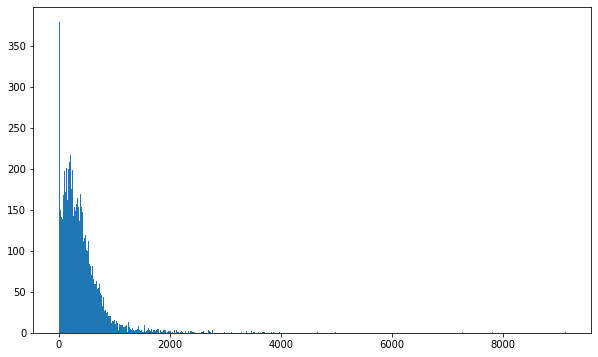

In [ ]:
#Analisando a distribuição da extensão dos textos que estão sob análise 

plt.figure(figsize = (10,6))
plt.hist([len(x) for x in X], bins = 500)
plt.show()

#A maioria de nossos textos tem até 1100 palavras.

In [ ]:
#Número de textos (é o mesmo do nosso df)

tamanhotexto = np.array([len(x) for x in X])
len(tamanhotexto)

6335

In [ ]:
#Quantidade de textos com mais de 1100 palavras

len(tamanhotexto[tamanhotexto > 1100])

267

In [ ]:
#Como estamos trabalhando com DL todas os dados deverão ter o mesmo shape. Para isso vamos executar a ação abaixo.

maxlen = 1100
X = pad_sequences(X, maxlen = maxlen)

In [ ]:
#Confirmando se um texto qq está setado para 1100 palavras de extensão.

len(X[132])

1100

In [ ]:
#Para tratar possíveis VOO
vocab_size=len(tokenizer.word_index)+1

vocab = tokenizer.word_index


In [ ]:
#Essa função irá adicionar o conteúdo do nosso w2v em uma matriz cotendo todas as palavras.
#Iremos usar os vetores oriundos da ação do w2v como pesos iniciais na nossa rede neural.

def get_weight_matrix(model):
  weight_matrix = np.zeros((vocab_size, DIM))
  
  for word,i in vocab.items():
    weight_matrix[i] = model.wv[word]
  
  return weight_matrix

In [ ]:
#Vamos usar os vetores produzidos pelo w2v como pesos iniciais em nossa rede neural LSTM.

embedding_vectors = get_weight_matrix(w2v_model)

In [ ]:
embedding_vectors.shape

(83466, 100)

In [ ]:
#Construindo nossa rede neural do tipo LSTM.
#Nosso df é balanceado então vamos usar 'acc' como métrica.
clf0 = Sequential()
clf0.add(Embedding(vocab_size, output_dim = DIM, weights = [embedding_vectors],input_length = maxlen,trainable = False))
clf0.add(LSTM(units = 128))
clf0.add(Dense(1, activation='sigmoid'))
clf0.compile(optimizer = 'adam', loss = 'binary_crossentropy',metrics = ['acc'])

In [ ]:
clf0.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, 1100, 100)         8346600   
                                                                 
 lstm (LSTM)                 (None, 128)               117248    
                                                                 
 dense (Dense)               (None, 1)                 129       
                                                                 
Total params: 8,463,977
Trainable params: 117,377
Non-trainable params: 8,346,600
_________________________________________________________________


In [ ]:
#Dividindo nossos dados em treino e teste.

X_train, X_test, y_train, y_test = train_test_split(X,y, test_size = 0.3, random_state = 13)

In [ ]:
#Fazendo um callback para aumentar a eficiência do processo. Se nossa loss não melhorar por quatro epochs, o aprendizado para 
#e ficamos com o melhor conjunto de pesos produzido até o momento.

callback = tf.keras.callbacks.EarlyStopping(monitor = 'loss', patience = 4, restore_best_weights = True)

#Fitando nosso modelo 

model_0 = clf0.fit(X_train, y_train, validation_split = 0.3, epochs = 20, callbacks = [callback])


Epoch 1/20
97/97 [==============================] - 10s 68ms/step - loss: 0.4699 - acc: 0.7860 - val_loss: 0.3882 - val_acc: 0.8355
Epoch 2/20
97/97 [==============================] - 6s 63ms/step - loss: 0.3812 - acc: 0.8411 - val_loss: 0.3944 - val_acc: 0.8332
Epoch 3/20
97/97 [==============================] - 6s 63ms/step - loss: 0.3592 - acc: 0.8434 - val_loss: 0.3946 - val_acc: 0.8415
Epoch 4/20
97/97 [==============================] - 7s 70ms/step - loss: 0.3366 - acc: 0.8508 - val_loss: 0.3683 - val_acc: 0.8490
Epoch 5/20
97/97 [==============================] - 6s 63ms/step - loss: 0.2972 - acc: 0.8801 - val_loss: 0.4083 - val_acc: 0.8302
Epoch 6/20
97/97 [==============================] - 8s 79ms/step - loss: 0.3191 - acc: 0.8595 - val_loss: 0.3616 - val_acc: 0.8520
Epoch 7/20
97/97 [==============================] - 6s 62ms/step - loss: 0.2647 - acc: 0.8879 - val_loss: 0.3552 - val_acc: 0.8482
Epoch 8/20
97/97 [==============================] - 6s 62ms/step - loss: 0.2468 - 

In [ ]:
y_pred = (clf0.predict(X_test) > 0.5).astype(int)

In [ ]:
y_pred

array([[1],
       [1],
       [0],
       ...,
       [0],
       [0],
       [0]])

In [ ]:
accuracy_score(y_test, y_pred)

0.8890057864281957

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.88      0.90      0.89       958
           1       0.90      0.88      0.89       943

    accuracy                           0.89      1901
   macro avg       0.89      0.89      0.89      1901
weighted avg       0.89      0.89      0.89      1901



In [ ]:
#Salvar Modelo
dump(clf0, 'ANN_LSTM.joblib')

['ANN_LSTM.joblib']

In [ ]:
#Construindo um dicionário para alocar dados de qualidade dos modelos

from sklearn.metrics import classification_report, recall_score, precision_score

model_metrics = dict()

model_metrics['recall/modelo_0)'] = recall_score(y_test, y_pred)
model_metrics['precision/modelo_0'] = precision_score(y_test, y_pred)
model_metrics['accuracy/modelo_0'] = accuracy_score(y_test, y_pred)
model_metrics 

{'accuracy/modelo_0': 0.8890057864281957,
 'precision/modelo_0': 0.8969631236442517,
 'recall/modelo_0)': 0.8769883351007424}

In [ ]:
#Vamos testar outro modelo;
#Parte da preparação dos dados será diferente, pois não usaremos rede neural;
#Como nossos dados não são muito volumosos usaremos algoritmos mais simples pra ver se obtemos melhor acurácia (mas a obtida até o momento está adequada);

In [ ]:
#Nosso df 'limpo'.
#Coloquei uma palavra ('class') reservada no nome de uma coluna....irei alterar.

df_work

,text,class
0,daniel greenfield shillman journalism fellow f...,0
1,google pinterest digg linkedin reddit stumbleu...,0
2,secretary state john f kerry said monday stop ...,1
3,kaydee king kaydeeking november lesson tonight...,0
4,primary day new york frontrunners hillary clin...,1
...,...,...
6330,state department told republican national comm...,1
6331,p pbs stand plutocratic pentagon posted oct wi...,0
6332,antitrump protesters tools oligarchy reform pr...,0
6333,addis ababa ethiopia president obama convened ...,1


In [ ]:
#ALterando nome da coluna 'class' para 'classe'.

df_work.rename(columns={"class":"classe"}, inplace=True)

/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:5047: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


In [ ]:
Xnovomod = df_work.text.values
ynovomod = df_work.classe.values

In [ ]:
#Splitando os dados em treino e teste.

Xnm_train, Xnm_test, ynm_train, ynm_test = train_test_split(Xnovomod,ynovomod, test_size = 0.3, random_state = 13)

In [ ]:
print(Xnm_train.shape, ynm_train.shape)
print(Xnm_test.shape, ynm_test.shape)

(4434,) (4434,)
(1901,) (1901,)


In [ ]:
#Processando os dados para os algoritmos que utilizaremos.
#O processamento será diferente do utilizado para a rede neural.

from sklearn.feature_extraction.text import CountVectorizer


In [ ]:
vect = CountVectorizer(preprocessor = clean, max_features = 5000) 

Xnm_train_one = vect.fit_transform(Xnm_train)

Xnm_test_one = vect.transform(Xnm_test)



In [ ]:
#Salvar o nosso vetorizador

dump(vect, 'vetorizacao.joblib')

['vetorizacao.joblib']

In [ ]:
#Iremos testar o algoritmo Linear Support Vector Classification.

from sklearn.svm import LinearSVC

In [ ]:
clf1 = LinearSVC(random_state = 13) 

model_1 = clf1.fit(Xnm_train_one, ynm_train) 

/usr/local/lib/python3.7/dist-packages/sklearn/svm/_base.py:1208: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  ConvergenceWarning,


In [ ]:
y_pred_nm_SVM = model_1.predict(Xnm_test_one)

In [ ]:
accuracy_score(ynm_test, y_pred_nm_SVM) #Obtivemos 87% de acurácia no nossos dados.

0.8779589689637033

In [ ]:
#Salvando modelo_1
dump(clf1, 'SVM_model.joblib')

['SVM_model.joblib']

In [ ]:
#Dicionário de métricas dos modelos 

model_metrics['recall/modelo_SVM)'] = recall_score(ynm_test, y_pred_nm_SVM)
model_metrics['precision/modelo_SVM'] = precision_score(ynm_test, y_pred_nm_SVM)
model_metrics['accuracy/modelo_SVM'] = accuracy_score(ynm_test, y_pred_nm_SVM)

model_metrics 

{'accuracy/modelo_0': 0.8890057864281957,
 'accuracy/modelo_SVM': 0.8779589689637033,
 'precision/modelo_0': 0.8969631236442517,
 'precision/modelo_SVM': 0.8777895855472901,
 'recall/modelo_0)': 0.8769883351007424,
 'recall/modelo_SVM)': 0.8759278897136797}

In [ ]:
##Iremos testar o algoritmo LogisticRegression

from sklearn.linear_model import LogisticRegression

In [ ]:
clf2 = LogisticRegression(max_iter = 400) # Instaciando o modelo
modelo_2 = clf2.fit(Xnm_train_one, ynm_train) # Fitando o modelo


In [ ]:
y_pred_nm_LR = modelo_2.predict(Xnm_test_one)

In [ ]:
accuracy_score(ynm_test, y_pred_nm_LR) #Obtivemos 90% de acurácia no nossos dados. Melhor desempenho. Vamos usar este modelo.

0.9058390320883746

In [ ]:
#Salvando modelo_2
dump(clf2, 'reg_log.joblib')

['reg_log.joblib']

In [ ]:
#Dicionário de métricas dos modelos 

model_metrics['recall/reg_log)'] = recall_score(ynm_test, y_pred_nm_LR)
model_metrics['precision/reg_log'] = precision_score(ynm_test, y_pred_nm_LR)
model_metrics['accuracy/reg_log'] = accuracy_score(ynm_test, y_pred_nm_LR)

model_metrics 

{'accuracy/modelo_0': 0.8890057864281957,
 'accuracy/modelo_SVM': 0.8779589689637033,
 'accuracy/reg_log': 0.9058390320883746,
 'precision/modelo_0': 0.8969631236442517,
 'precision/modelo_SVM': 0.8777895855472901,
 'precision/reg_log': 0.9134199134199135,
 'recall/modelo_0)': 0.8769883351007424,
 'recall/modelo_SVM)': 0.8759278897136797,
 'recall/reg_log)': 0.8950159066808059}

In [ ]:
#Salvando as métricas do modelo1 em um json no diretório 'metrics'

with open('model_metrics_version_0.json', 'w') as fp:
    json.dump(model_metrics, fp)
